In [1]:
import copy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from asammdf import MDF, Signal
import scipy.integrate as integrate
import seaborn as sns
import plotly.express as px
from pathlib import Path

data_dir = Path(r"C:\Users\frank\Box Sync\School\DME\Eindopdracht\Data")
# data_dir =Path (r"C:\Users\enfmeske\Box Sync\Frank Meskes workspace\School\DME\Eindopdracht\Data")
file_path = data_dir / r"E214E01752T_R4_230129_whole_Day.mf4"

# signals
mdf = MDF(file_path)
if __name__ == "__main__":
    for file in data_dir.glob("*"):
        print(file.name.split("_")[2])
        # print(file[15:-14])
        # print(os.path.join(dir_name, file))
        # whatever(os.path.join(dir_name, file))

# signal selection
FILTER_LIST = [
    "TCU_CCVS_Wheelbasedvehiclespeed",
    "HS_Lift_Height",
    "ECM_EEC1_Engine_Speed",
    "ECM_EEC2_AccelPedalPos1",
    "ECM_EEC1_Engine_Actual_Eng_Torqu",
    "ECM_EEC2_EngPercLoadAtCurrSpd",
    "ECM_EEC3_NomFrictionPercTorq",
    "ECM_LFE1_FuelRate",
    "JOY_BJM1_Hoist_Percentage",
    "GPS_latitude",
    "GPS_longitude",
    "GPS_speed",
    "GPS_altitude",
    "PS_Pressure_Sensor_Lift",
    "PS_Sensor_Brake",
    "JOY_BJM1_Hoist_Lift_Status",
    "JOY_BJM1_Hoist_Lower_Status",
    "JOY_BJM1_Tilt_Forward_Status",
    "JOY_BJM1_Tilt_Backward_Status",
    "JOY_EJM1_PileSlope_Back_Status",
    "JOY_EJM1_PileSlope_Fwd_Status",
    "JOY_BJM1_Spreader_Extend",
    "JOY_BJM1_Spreader_Retract",
    "JOY_BJM1_Spreader_SideShiftLeft",
    "JOY_BJM1_Spreader_SideShiftRight",
    "JOY_BJM1_Spreader_Twist_Unlock",
    "JOY_BJM1_Spreader_Twistlock_Lock",
]
# print(filter_list)

# Commonname list
CNAME_DICT = {
    "HS_Lift_Height": "Lift_Height",
    "TCU_CCVS_Wheelbasedvehiclespeed": "Vehicle_speed",
    "ECM_EEC1_Engine_Speed": "Engine_Speed",
    "ECM_EEC2_AccelPedalPos1": "AccelPedalPos",
    "JOY_BJM1_Hoist_Percentage": "Hoist_Percentage",
    "ECM_EEC1_Engine_Actual_Eng_Torqu": "Engine_Actual_Torq",
    "ECM_EEC2_EngPercLoadAtCurrSpd": "EngPercLoadAtCurrSp",
    "ECM_EEC3_NomFrictionPercTorq": "NomFrictionPercTorq",
    "ECM_LFE1_FuelRate": "FuelRate",
    "PS_Pressure_Sensor_Lift": "Lift_pressure_raw",
    "PS_Sensor_Brake": "Brake_pressure_raw",
    "GPS_latitude": "lat",
    "GPS_longitude": "lon",
    "JOY_BJM1_Hoist_Lift_Status": "Lift_Status",
    "JOY_BJM1_Hoist_Lower_Status": "Lower_Status",
    "JOY_BJM1_Tilt_Forward_Status": "Tilt_Fwd",
    "JOY_BJM1_Tilt_Backward_Status": "Tilt_Bwd",
    "JOY_EJM1_PileSlope_Back_Status": "PPS_Bwd",
    "JOY_EJM1_PileSlope_Fwd_Status": "PPS_Fwd",
    "JOY_BJM1_Spreader_Extend": "Spr_Extend",
    "JOY_BJM1_Spreader_Retract": "Spr_Retract",
    "JOY_BJM1_Spreader_SideShiftLeft": "SS_Left",
    "JOY_BJM1_Spreader_SideShiftRight": "SS_Right",
    "JOY_BJM1_Spreader_Twist_Unlock": "TWL_Unlock",
    "JOY_BJM1_Spreader_Twistlock_Lock": "TWL_Lock",
}


filtered_mdf = mdf.filter(FILTER_LIST)

# resample to 10Hz
resampled_signals = filtered_mdf.resample(1)  # resample to 1Hz

# add to dataframe
df = resampled_signals.to_dataframe()  # mdf to pandas Use datetime

# rename
df.rename(columns=CNAME_DICT, inplace=True)

# df.save(f"{file_path[:-4]}_temp_resample.mf4", compression=2)

ldf is not supported
xls is not supported
xlsx is not supported


230128
230129
230130
230131
230201
230202


In [3]:
# Power calculation
RefTorque = 850
df["EngineTorque"] = (df.Engine_Actual_Torq - df.NomFrictionPercTorq) * RefTorque / 100
df["EnginePower"] = df.EngineTorque * (df.Engine_Speed * 2 * np.pi / 60) / 1000

# Power accumulation
df["EnginePower_acc"] = (
    integrate.cumulative_trapezoid(df.EnginePower, df.index, initial=0) / 3600
)

# calculate lift load
Piston_diam = 12.5  # cm
piston_area = ((Piston_diam**2) * np.pi) / 8  # dev 8 for 2 cilinders

df["truck_Load"] = 10 * df.Lift_pressure_raw * piston_area / 10000  # in Tons

# calculate accped and Joystick rate
df["AccelP_rate"] = np.gradient(df.AccelPedalPos, df.index)
df["Hoist_rate"] = np.gradient(df.Hoist_Percentage, df.index)

# make categories for visualizations
df["truck_load_cat"] = pd.cut(
    df["truck_Load"],
    bins=[0, 5, 8, 10],
    include_lowest=False,
    labels=["low", "mid", "high"],
)

df["Vehicle_speed_cat"] = pd.cut(
    df["Vehicle_speed"],
    bins=[0, 5, 8, 25],
    include_lowest=False,
    labels=["low", "mid", "high"],
)
print ("done")


done


In [4]:
# State
def Func_Active(f1, f2):
    if f1 == True or f2 == True:
        return 1
    else:
        return 0


# df['Hoist_Active']= df.apply(lambda row:['Lift_Status'] : 1 if 500 < x < 920 else 0)
df["Hoist_Active"] = df.apply(
    lambda row: Func_Active(row["Lift_Status"], row["Lower_Status"]), axis=1
)
df["Tilt_Active"] = df.apply(
    lambda row: Func_Active(row["Tilt_Fwd"], row["Tilt_Bwd"]), axis=1
)
df["PPS_Active"] = df.apply(
    lambda row: Func_Active(row["PPS_Fwd"], row["PPS_Bwd"]), axis=1
)
df["SS_Active"] = df.apply(
    lambda row: Func_Active(row["SS_Left"], row["SS_Right"]), axis=1
)
df["Spr_Ext_Ret"] = df.apply(
    lambda row: Func_Active(row["Spr_Extend"], row["Spr_Retract"]), axis=1
)
df["TWL_Active"] = df.apply(
    lambda row: Func_Active(row["TWL_Lock"], row["TWL_Unlock"]), axis=1
)


# make a signal to see if the truck is hydraulic is active
def hydraulic_active(lift, tilt, pps, ss, spr, twl):
    if lift or tilt or pps or ss or spr or twl:
        return 1
    else:
        return 0


df["Hydr_Active"] = df.apply(
    lambda row: hydraulic_active(
        row["Hoist_Active"],
        row["Tilt_Active"],
        row["PPS_Active"],
        row["SS_Active"],
        row["Spr_Ext_Ret"],
        row["TWL_Active"],
    ),
    axis=1,
)


# Define driving state
def drive_only(Speed, Hydr):
    """Gives True when driving is active and Hydraulic is False"""
    if Speed >= 0.5 and not Hydr:
        return 1
    else:
        return 0


df["Drive_only"] = df.apply(
    lambda row: drive_only(row["Vehicle_speed"], row["Hydr_Active"]), axis=1
)


# Hydraulic only
def hydr_only(Hydr, Drive):
    """Gives True when driving is false and Hydraulic is active"""
    if not Drive and Hydr:
        return 1
    else:
        return 0


# Hydraulic only
def working(Hydr, speed):
    """Gives True when driving is True and Hydraulic is active"""
    if speed >= 0.5 and Hydr:
        return 1
    else:
        return 0


# Hydraulic only series
df["Hydr_only"] = df.apply(
    lambda row: hydr_only(row["Hydr_Active"], row["Drive_only"]), axis=1
)

# make working series
df["working"] = df.apply(
    lambda row: working(row["Hydr_Active"], row["Vehicle_speed"]), axis=1
)
# make a signal to see if the engine is idling
df["Engine_Idle"] = df["Engine_Speed"].apply(lambda x: 1 if 500 < x < 920 else 0)


# Function to determine idle state, Gives true when idle is true and drv is false
def truck_idle(idle_active, drv_active, hydr_active):
    """Gives true when idle is true and drv is false"""
    if idle_active and not drv_active and not hydr_active:
        return 1
    else:
        return 0


# apply the function with lambda
df["Truck_Idle"] = df.apply(
    lambda row: truck_idle(row["Engine_Idle"], row["Drive_only"], row["Hydr_only"]),
    axis=1,
)


# truck state
def truck_state(idle, drive, hydr, work):
    # print("truck state")
    if work:
        return "Working"
    elif hydr:
        return "Hydraulic"
    elif drive:
        return "Driving"
    elif idle:
        return "Idle"
    else:
        return "None"


df["Truck_State"] = df.apply(
    lambda row: truck_state(
        row["Truck_Idle"], row["Drive_only"], row["Hydr_only"], row["working"]
    ),
    axis=1,
)

##power per system
df["Drive_power"] = df.apply(
    lambda row: row["EnginePower"] if row["Drive_only"] == True else 0, axis=1
)

df["Hydr_power"] = df.apply(
    lambda row: row["EnginePower"] if row["Hydr_only"] == True else 0, axis=1
)
df["Idle_power"] = df.apply(
    lambda row: row["EnginePower"] if row["Truck_Idle"] == True else 0, axis=1
)

df["Drive_energy"] = (
    integrate.cumulative_trapezoid(df.Drive_power, df.index, initial=0) / 3600
)
df["Hydr_energy"] = (
    integrate.cumulative_trapezoid(df.Hydr_power, df.index, initial=0) / 3600
)
df["Idle_energy"] = (
    integrate.cumulative_trapezoid(df.Idle_power, df.index, initial=0) / 3600
)

Total_Eng_nrg = np.mean(df["EnginePower_acc"])
Drive_nrg = np.mean(df["Drive_energy"])
Hydr_nrg = np.mean(df["Hydr_energy"])
Idle_nrg = np.mean(df["Idle_energy"])

print(np.mean(df["Drive_power"]))
print(np.mean(df["Hydr_power"]))
print(np.mean(df["Idle_power"]))
print(f" Total Power{Total_Eng_nrg}")

Nrg_list = [Total_Eng_nrg, Drive_nrg, Hydr_nrg, Idle_nrg]
Nrg_N_list = ["Total_Eng_nrg", "Drive_nrg", "Hydr_nrg", "Idle_nrg"]
print(df.Truck_State.head(20))

1.281280491931108
1.2169673856282202
2.2083637046109312
 Total Power53.40125756897256
timestamps
0.0       Driving
1.0       Driving
2.0       Driving
3.0          Idle
4.0          Idle
5.0          Idle
6.0     Hydraulic
7.0       Working
8.0       Working
9.0       Working
10.0      Working
11.0    Hydraulic
12.0    Hydraulic
13.0    Hydraulic
14.0    Hydraulic
15.0    Hydraulic
16.0    Hydraulic
17.0    Hydraulic
18.0         Idle
19.0         Idle
Name: Truck_State, dtype: object


In [5]:
# Remove rows with idle
df_run = df.copy()
df_run = df_run[df_run["Truck_Idle"] == False]
# working cut
df_working = df.copy()
df_working = df_working[df_working["Truck_State"] == "Working"]
# Driving cut
df_drive = df.copy()
df_drive = df_drive[df_drive["Truck_State"] == "Driving"]
# Hydr cut
df_Hydr = df.copy()
df_Hydr = df_Hydr[df_Hydr["Truck_State"] == "Hydr_Active"]

# Hydr cut
COLUMN_LIST = [
    "AccelPedalPos",
    "Hoist_Percentage",
    "EngPercLoadAtCurrSp",
    "FuelRate",
    "EnginePower",
    "Truck_State",
]

df_plot = df.loc[:, COLUMN_LIST]


# print(df.head(25))
print("visualizations")

visualizations


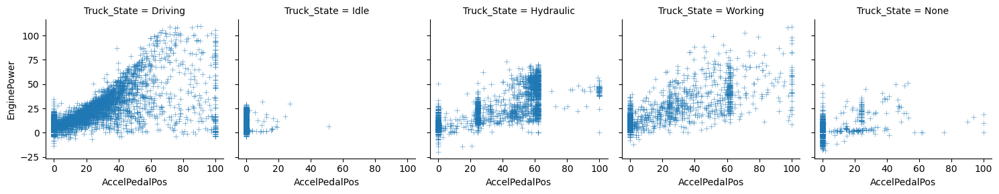

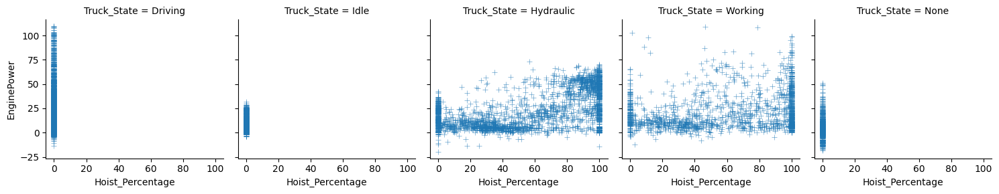

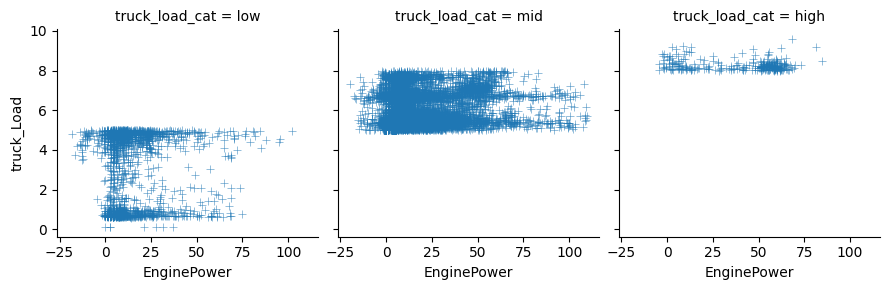

In [6]:
# distribution Acell pedal
g = sns.FacetGrid(df, col="Truck_State")
g.map(sns.scatterplot, "AccelPedalPos", "EnginePower", alpha=0.7, marker="+")
# distribution Hoist
g = sns.FacetGrid(df, col="Truck_State")
g.map(sns.scatterplot, "Hoist_Percentage", "EnginePower", alpha=0.7, marker="+")
# distribution EngineSpeed
g = sns.FacetGrid(df, col="truck_load_cat")
g.map(
    sns.scatterplot,
    "EnginePower",
    "truck_Load",
    alpha=0.7,
    marker="+",
)

# sns.scatterplot(df, x="Hoist_Percentage", y="FuelRate", hue="Truck_State")


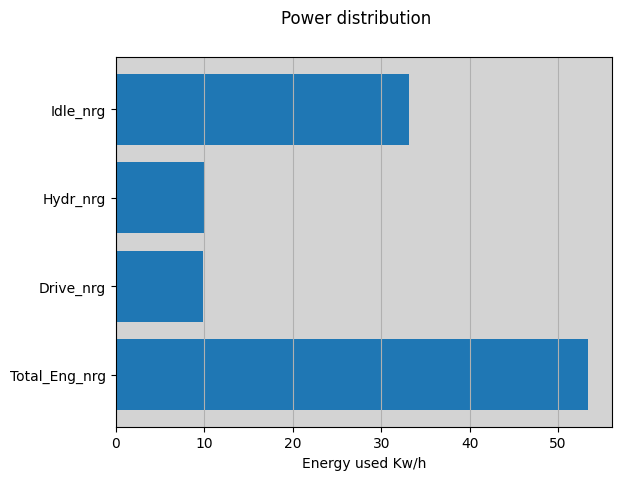

<Figure size 1500x500 with 0 Axes>

In [7]:
# Set graph
fig, (ax1) = plt.subplots()
# Set title
fig.suptitle("Power distribution")
# figure size
fig = plt.figure(figsize=(15, 5))
# plot
ax1.barh(Nrg_N_list, Nrg_list, align="center")
# Set backgound color
ax1.set_facecolor("lightgrey")
# add a grid
ax1.grid(axis="x")
# set label
ax1.set_xlabel("Energy used Kw/h")
plt.show()

In [8]:
# # plotly test
fig = px.histogram(df, x="FuelRate", color="Truck_State", nbins=50, marginal="box")
fig.show()


In [9]:
# boxplot
fig = px.box(df, x="Truck_State", y="FuelRate", color="Truck_State")
fig.show()

In [10]:
# plot gps data
fig = px.scatter_mapbox(
    df,
    lat="lat",
    lon="lon",
    hover_data=["Vehicle_speed", "truck_Load", "Lift_Height"],
    color="Truck_State",
    color_continuous_scale=[
        (0, "Green"),
        (0.5, " yellow"),
        (0.7, "red"),
        (1, "Purple"),
    ],
    zoom=15,
    height=900,
)
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox_layers=[
        {
            "below": "traces",
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ],
        }
    ],
    margin={"r": 0, "t": 0, "l": 0, "b": 0},
)
fig.show()

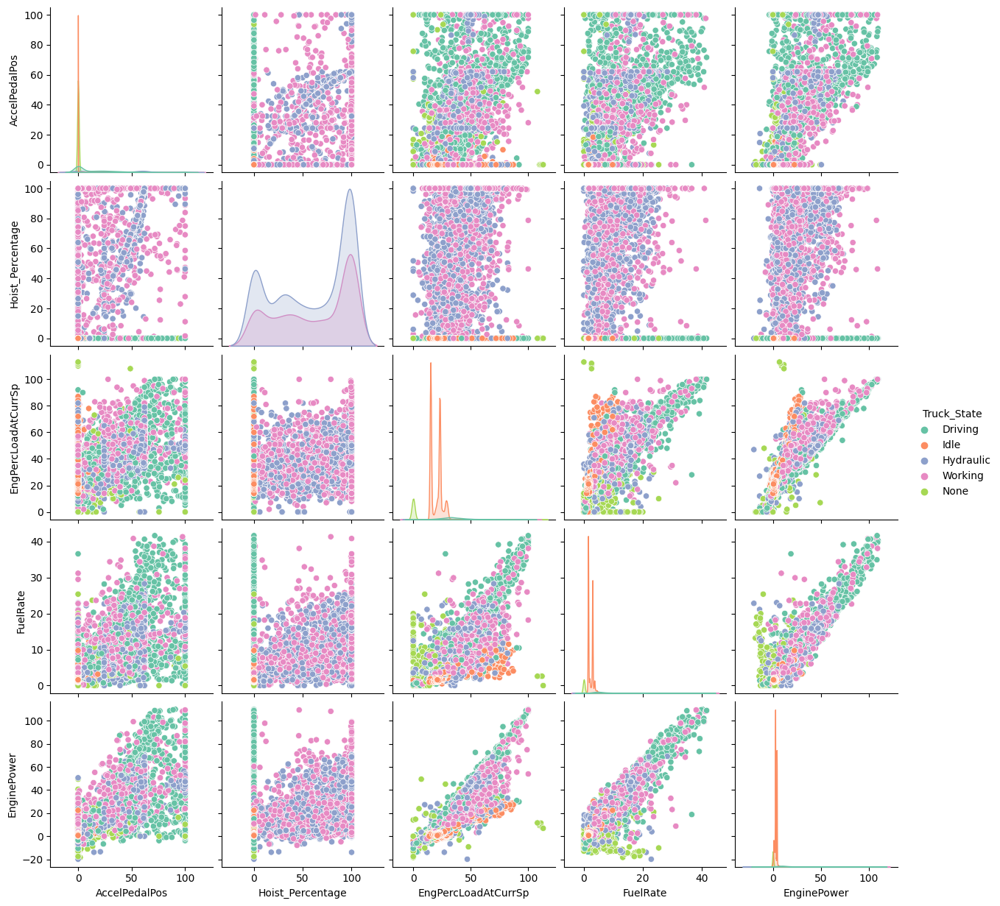

In [11]:
# pair plot subser
g = sns.pairplot(
    df_plot, hue="Truck_State", palette="Set2", diag_kind="kde", height=2.5
)
# fig.show()

C:\Users\frank\AppData\Local\Temp\ipykernel_15984\935437815.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



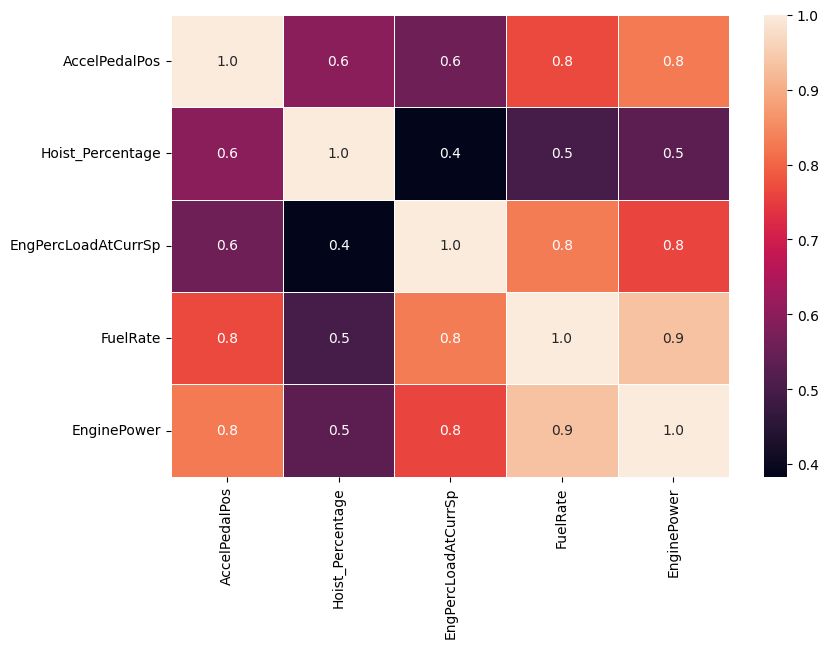

In [13]:
corr = df_plot.corr()
# print(corr)

# Draw a heatmap with the numeric values in each cell
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(corr, annot=True, fmt=".1f", linewidths=0.5, ax=ax)
plt.show()